In [5]:
%matplotlib inline 

from weibo.get_weibo import get_weibo
from weibo.baidu_nltk import get_sentiment_simple, get_sentiment_positive_proba, tokenize,tokenize_df

import pandas as pd
import numpy as np
import utilities.misc as um
import utilities.constants as uc
import utilities.display as ud

import time


from wordcloud import WordCloud
from scipy.misc import imread

import matplotlib.pyplot as plt

import feather
from blp.bdx import bdh

In [260]:
# load the data
font_path='D:\\data\\weibo\\stfangsong\\chinese.stfangso.ttf'
path="D:\\data\\weibo\\"
weibo=feather.read_dataframe(path+'data.feather')
weibo_sentiment=feather.read_dataframe(path+'data_with_sentiment.feather')
words=feather.read_dataframe(path+'words.feather')
words_translation=pd.read_excel(path+'words_translation.xlsx',sheet_name='Sheet1')

In [261]:
english_name={'冠状病毒':'coronavirus','口罩':'mask','医生':'doctor','野味':'wild_animals','湖北':'hubei','武汉':'wuhan','疫情':'epidemic'}

weibo['topic_e']=weibo['topic'].map(lambda x: english_name[x])
words['topic_e']=words['topic'].map(lambda x: english_name[x])
words_translation['topic_e']=words_translation['topic'].map(lambda x: english_name[x])
weibo_sentiment['topic_e']=weibo_sentiment['topic'].map(lambda x: english_name[x])

In [262]:
# manually modify the translation
to_drop=['Example']
words_translation=words_translation[~words_translation['item_e'].isin(to_drop)]

In [263]:
# get the word cloud

# lock the word cloud obj
wc_chinese=WordCloud(
        background_color='black',
        #mask=backgroup_mask,   
        max_words=1000,
        font_path=font_path,
        max_font_size=100,
        colormap='hsv')

wc_english=WordCloud(
        background_color='black',
        #mask=backgroup_mask,   
        max_words=1000,
        #font_path='D:\\data\\weibo\\stfangsong\\chinese.stfangso.ttf',
        max_font_size=100,
        colormap='hsv')



C:\Users\user\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


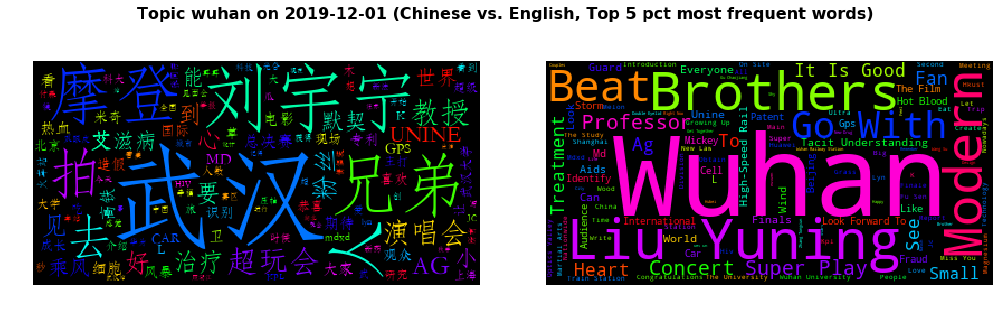

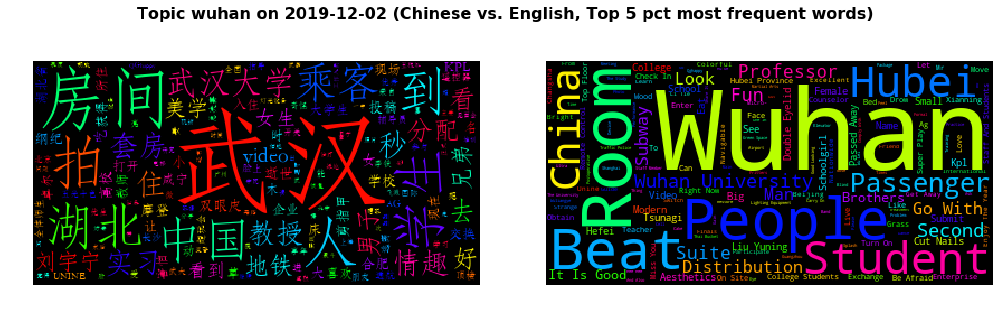

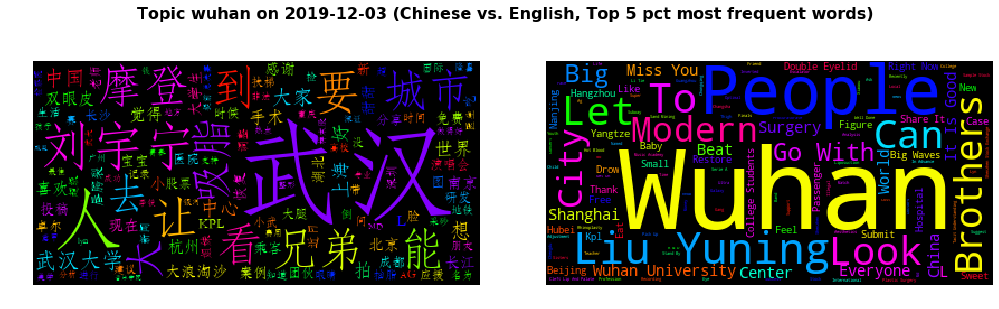

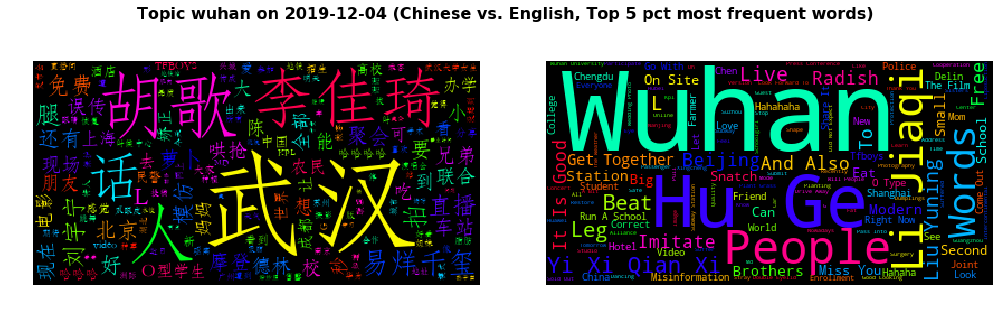

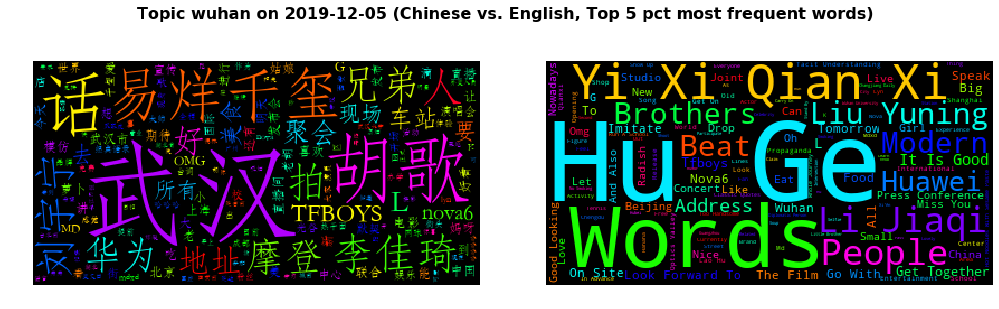

...

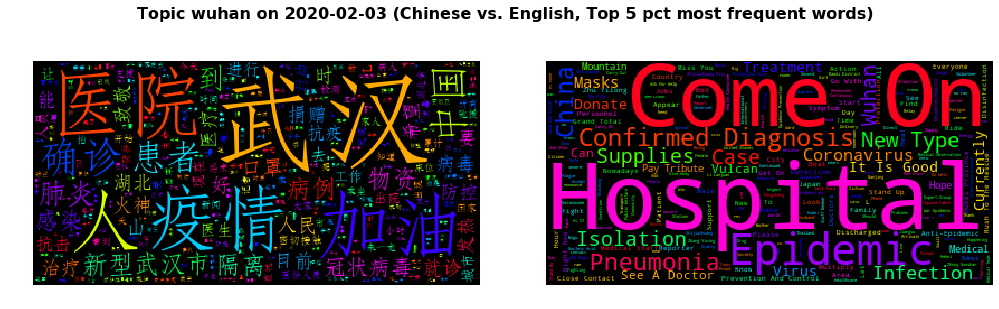

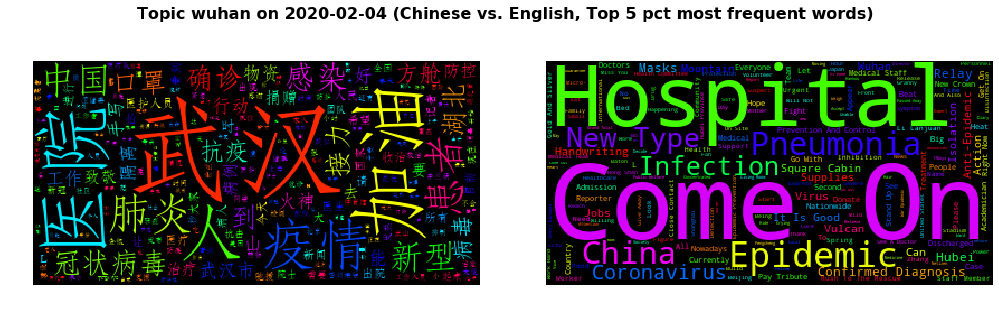

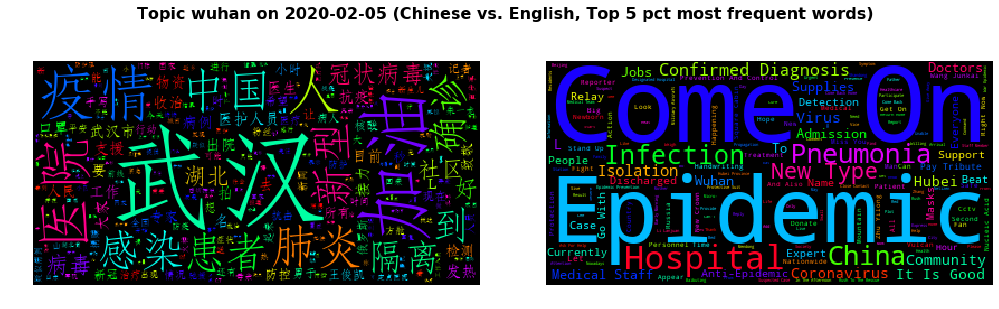

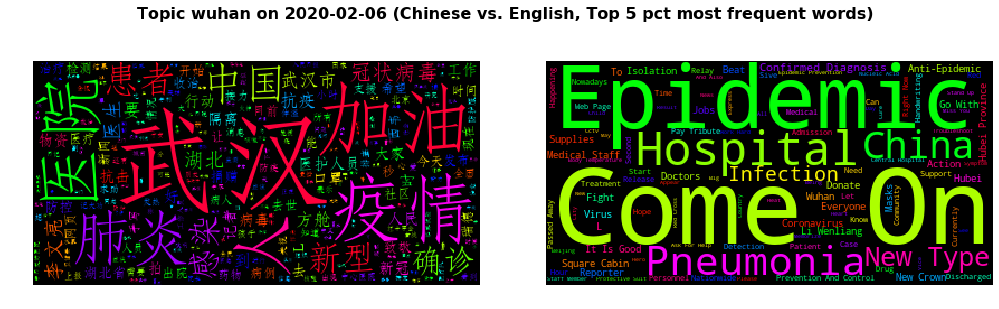

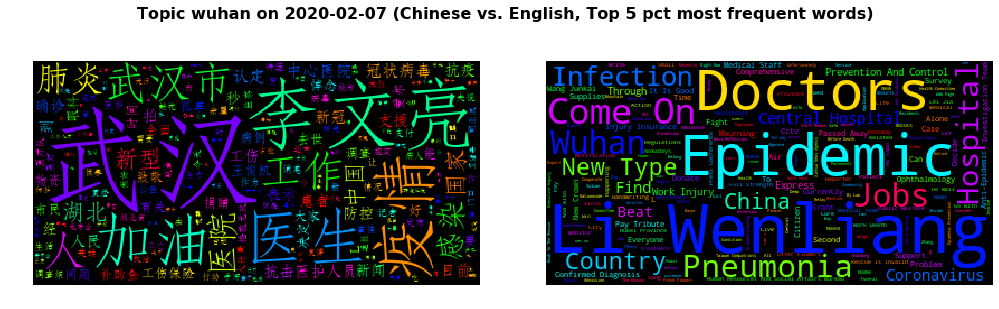

In [99]:
topic_e='wuhan'

freq=words_translation.set_index(['topic_e','date']).loc[topic_e]
dates=freq.reset_index().groupby('date').last().index

for date in dates:
    
    fig,axes=ud.easy_plot_quick_subplots((1,2),'Topic %s on %s (Chinese vs. English, Top 5 pct most frequent words)' % (topic_e,date.strftime('%Y-%m-%d')))
    #chinese
    word_cloud =wc_chinese.generate_from_frequencies(freq.loc[date].set_index('item')['prop'].to_dict())
    axes[0].imshow(word_cloud)
    axes[0].axis("off")
    
    #english
    word_cloud =wc_english.generate_from_frequencies(freq.loc[date].set_index('item_e')['prop'].to_dict())
    axes[1].imshow(word_cloud)
    axes[1].axis("off")
 

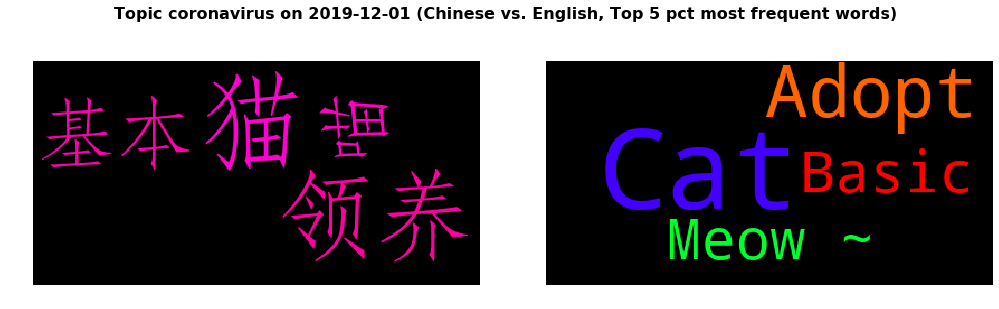

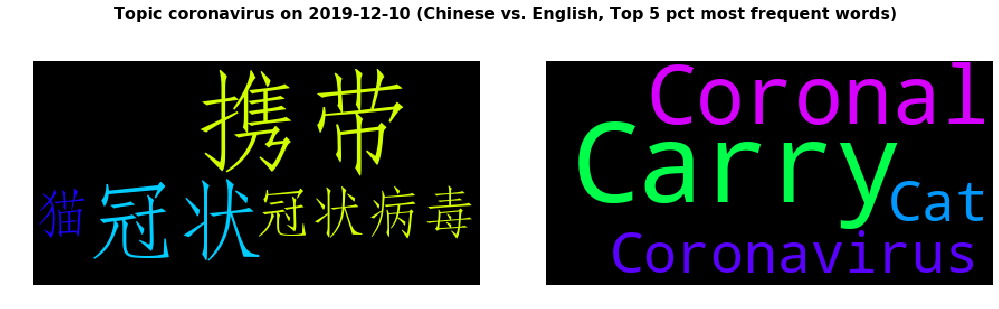

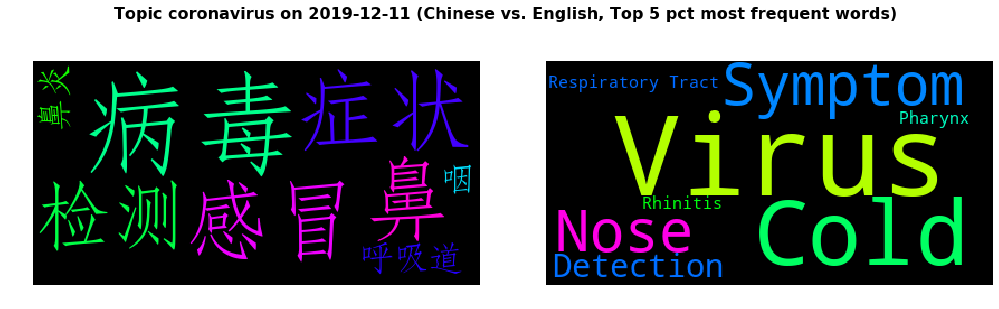

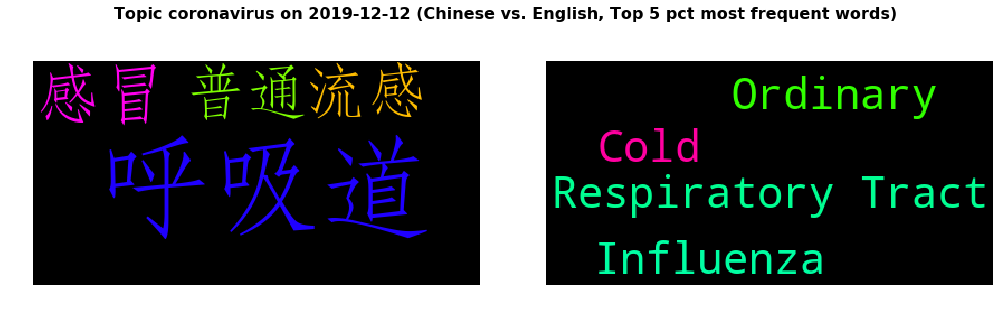

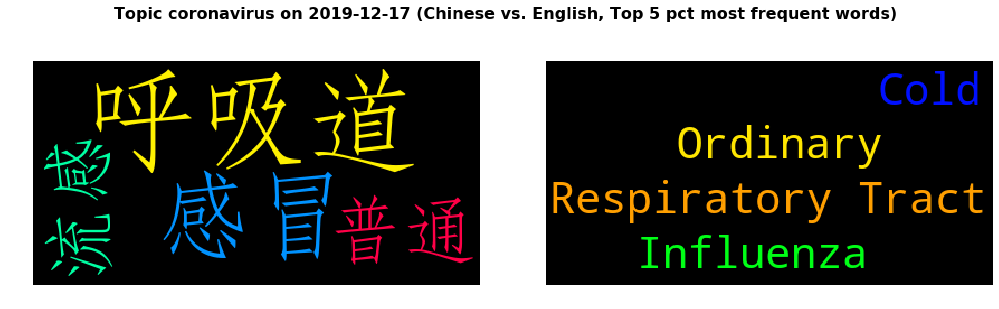

...

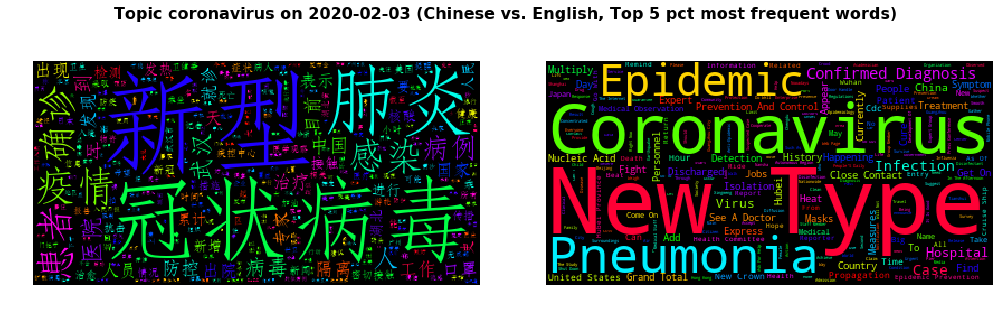

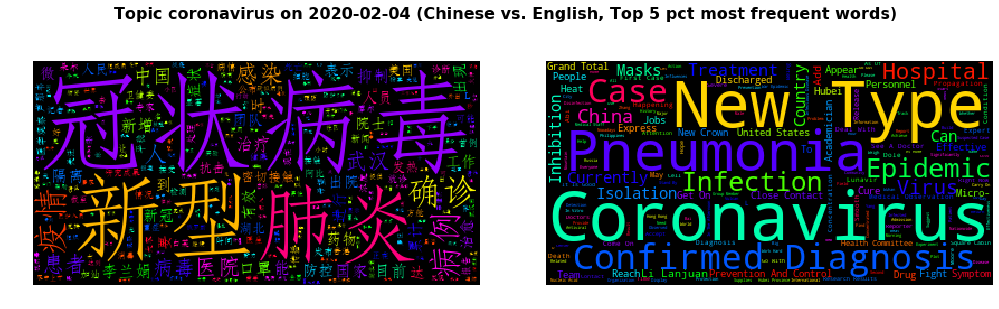

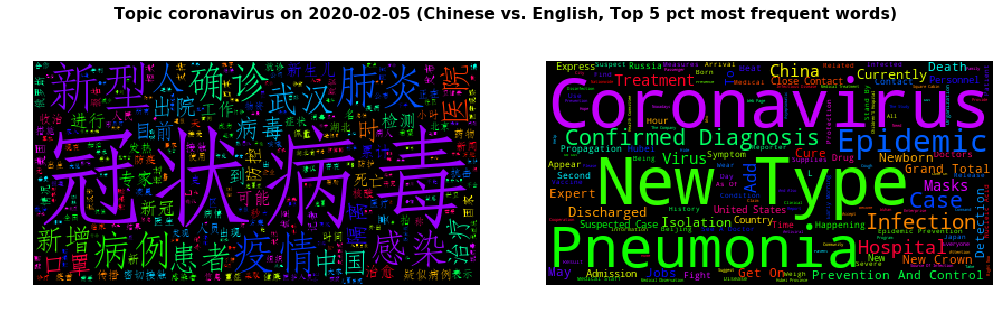

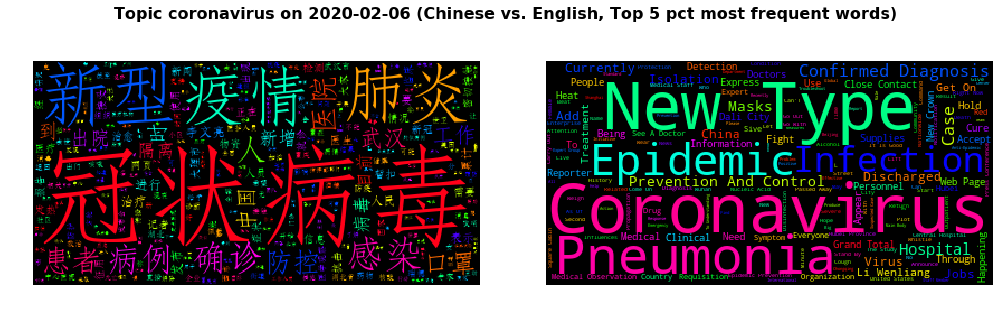

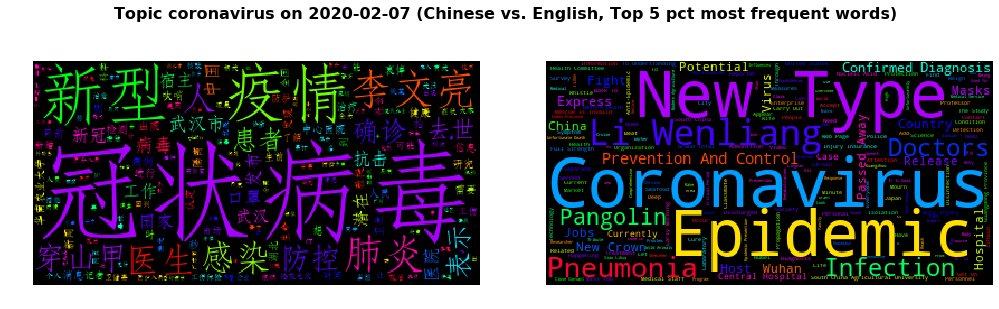

In [100]:
topic_e='coronavirus'

freq=words_translation.set_index(['topic_e','date']).loc[topic_e]
dates=freq.reset_index().groupby('date').last().index

for date in dates:
    
    fig,axes=ud.easy_plot_quick_subplots((1,2),'Topic %s on %s (Chinese vs. English, Top 5 pct most frequent words)' % (topic_e,date.strftime('%Y-%m-%d')))
    #chinese
    word_cloud =wc_chinese.generate_from_frequencies(freq.loc[date].set_index('item')['prop'].to_dict())
    axes[0].imshow(word_cloud)
    axes[0].axis("off")
    
    #english
    word_cloud =wc_english.generate_from_frequencies(freq.loc[date].set_index('item_e')['prop'].to_dict())
    axes[1].imshow(word_cloud)
    axes[1].axis("off")
 

In [69]:
# overview of sentiment count etc

Text(564.6704545454544, 0.5, '')

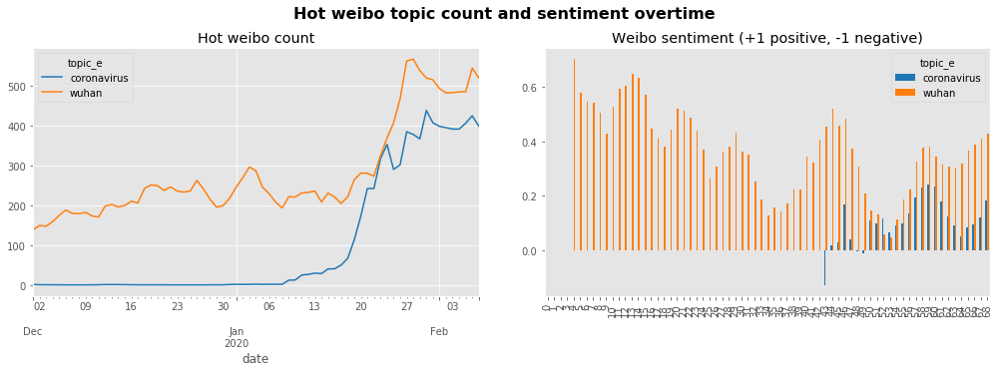

In [228]:
fig,axes=ud.easy_plot_quick_subplots((1,2),'Hot weibo topic count and sentiment overtime')

to_plot=weibo_sentiment.groupby(['date','topic_e']).count()['owner'].unstack().fillna(0).rolling(5,min_periods=1).mean()
color=[uc.alt_colors_quick_pd_plot[i*2] for i in np.arange(0,len(to_plot.columns),1)]
to_plot.plot(ax=axes[0],color=color,title='Hot weibo count')

to_plot=(weibo_sentiment.groupby(['date','topic_e']).mean()['sentiment'].unstack()-1).rolling(5,min_periods=5).mean()
to_plot.plot(ax=axes[1],title='Weibo sentiment (+1 positive, -1 negative)',color=color,kind='bar',use_index=False)
axes[1].grid(False)
axes[1].set_ylabel('')

# Potential chart 1: coronavirus sentiment vs. market

In [155]:
# plot blog vs market, and add an embedded plot to show the word cloud
nice_name={'SHSZ300 Index':'CSI300','SH000905 Index':'CSI500','SZ399006 Index':'ChiNext','HSCEI Index':'HSCEI'}
nice_order=['CSI300','ChiNext','HSCEI']
mkt=bdh(list(nice_name.keys()),['PX_LAST'],pd.datetime(2019,12,1),um.today_date())
mkt=mkt['PX_LAST'].unstack().T
mkt=mkt/mkt.iloc[0]
mkt=mkt.rename(columns=nice_name)
mkt=mkt[nice_order].fillna(method='ffill')

In [160]:
wb_count=weibo_sentiment.groupby(['date','topic_e'])['sentiment'].count().unstack()
wb_sentiment=weibo_sentiment.groupby(['date','topic_e'])['sentiment'].mean().unstack()-1

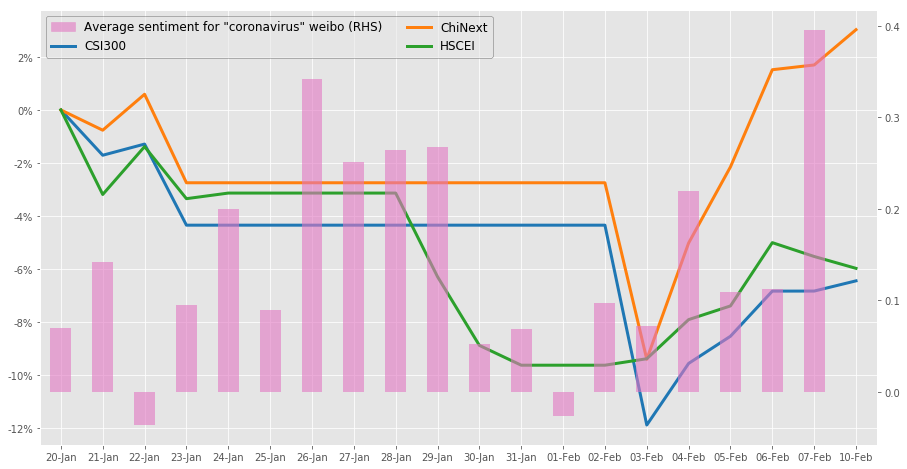

In [221]:
topic_i='coronavirus'
to_plot=pd.concat([wb_sentiment[topic_i],mkt],axis=1).loc[pd.datetime(2020,1,20):]
to_plot[nice_order]=to_plot[nice_order]/to_plot[nice_order].iloc[0]
to_plot[nice_order]=to_plot[nice_order].fillna(method='ffill')
to_plot[topic_i]=to_plot[topic_i].fillna(0)
to_plot.index=to_plot.index.map(lambda x: x.strftime('%d-%b'))

fig,ax=plt.subplots(1,1,figsize=(15,8))
(to_plot[nice_order]-1).plot(ax=ax,legend=False,color=[uc.alt_colors_quick[x*2] for x in np.arange(0,len(nice_order))],lw=3)
ud.easy_plot_pct_tick_label(ax,direction='y')
ax_sec=ax.twinx()
to_plot[topic_i].plot(ax=ax_sec,kind='bar',alpha=0.6,color=uc.alt_colors_quick[12])
ax_sec.grid(False)

#adding customized legend
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
legend_elements=[]
legend_elements.append(Patch(facecolor=uc.alt_colors_quick[12], edgecolor=uc.alt_colors_quick[12],alpha=0.6,label='Average sentiment for "%s" weibo (RHS)' % (topic_i)))
for i,mkt_i in enumerate(nice_order):
    legend_elements.append(Line2D([0], [0], color=uc.alt_colors_quick[i*2], lw=3, label=mkt_i))
ax.legend(handles=legend_elements, loc='upper left',framealpha=0.5,fancybox=True,fontsize=12,ncol=2).get_frame().set_edgecolor('k')


# Potential chart 2: coronavirus count vs. word cloud

In [291]:
# chinese version first
start_date=pd.datetime(2019,12,11)
key_periods={'Very few discussion':[start_date,pd.datetime(2019,12,30),4],
            'Quick incrase in public attention':[pd.datetime(2019,12,30),pd.datetime(2020,1,19),2],
             'Full public attention':[pd.datetime(2020,1,19),um.today_date(),6],            
            }
periods=['Very few discussion','Quick incrase in public attention','Full public attention']

topic_e='coronavirus'
freq=words_translation.set_index(['topic_e','date']).loc[topic_e]

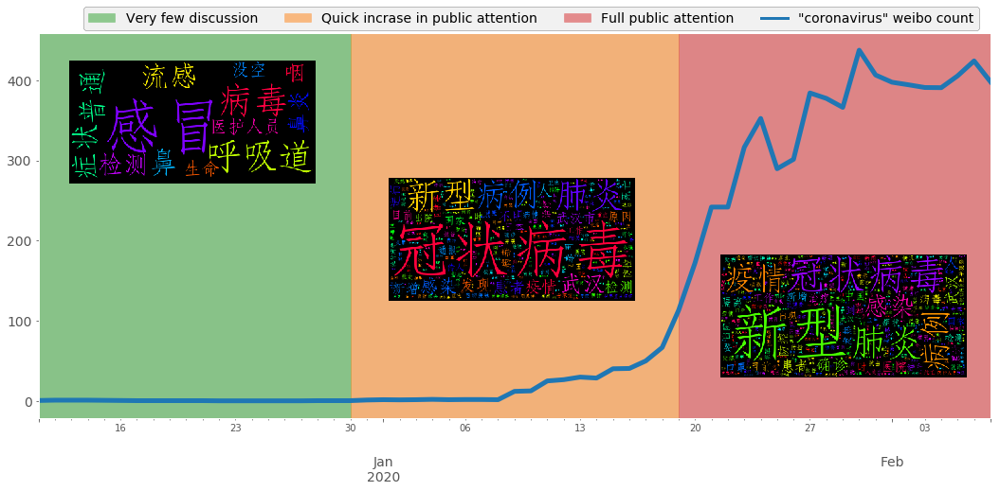

In [401]:
# now we do an embedded plot
col_name='item'
fig, ax = plt.subplots(1,1,figsize=(18,7.5))
wb_count_to_plot=wb_count[topic_e].fillna(0).rolling(5,min_periods=1).mean().loc[start_date:].plot(ax=ax,lw=5,color=uc.alt_colors_quick[0])
ax.set_xlabel('')
ax.grid(False)
legend_elements=[]


for period in periods:
    info_i=key_periods[period]
    start_i=info_i[0]
    end_i=info_i[1]
    color_i=info_i[2]
    
    ax.axvspan(start_i, end_i, alpha=0.5, color=uc.alt_colors_quick[color_i])
    
    wc_to_use=WordCloud(
        background_color='black',
        #mask=backgroup_mask,   
        max_words=1000,
        font_path=font_path,
        max_font_size=100,
        colormap='hsv',
        
#         width=800,
#         height =100,
        )
    
    legend_elements.append(Patch(facecolor=uc.alt_colors_quick[color_i], edgecolor=uc.alt_colors_quick[color_i],alpha=0.5,label=period))
    
legend_elements.append(Line2D([0], [0], color=uc.alt_colors_quick[0], lw=3, label='"%s" weibo count' % (topic_e)))
ax.legend(handles=legend_elements, loc='upper left',framealpha=0.5,fancybox=True,fontsize=14,ncol=4,
         bbox_to_anchor=(0.04,1.085)).get_frame().set_edgecolor('k')
ax.tick_params(axis='both', which='major', labelsize=14)


# sub axes
left, bottom, width, height = [0.15, 0.58, 0.2, 0.25]
ax_1 = fig.add_axes([left, bottom, width, height])

left, bottom, width, height = [0.41, 0.35, 0.2, 0.25]
ax_2 = fig.add_axes([left, bottom, width, height])

left, bottom, width, height = [0.68, 0.2, 0.2, 0.25]
ax_3 = fig.add_axes([left, bottom, width, height])

sub_axes=[ax_1,ax_2,ax_3]

for i,period in enumerate(periods):
    info_i=key_periods[period]
    start_i=info_i[0]
    end_i=info_i[1]
    color_i=info_i[2]
    
    freq_i=freq.loc[start_i:end_i].groupby(col_name).sum()['prop'].to_dict()
    word_cloud =wc_to_use.generate_from_frequencies(freq_i)
    
    sub_axes[i].imshow(word_cloud)
    sub_axes[i].axis("off")



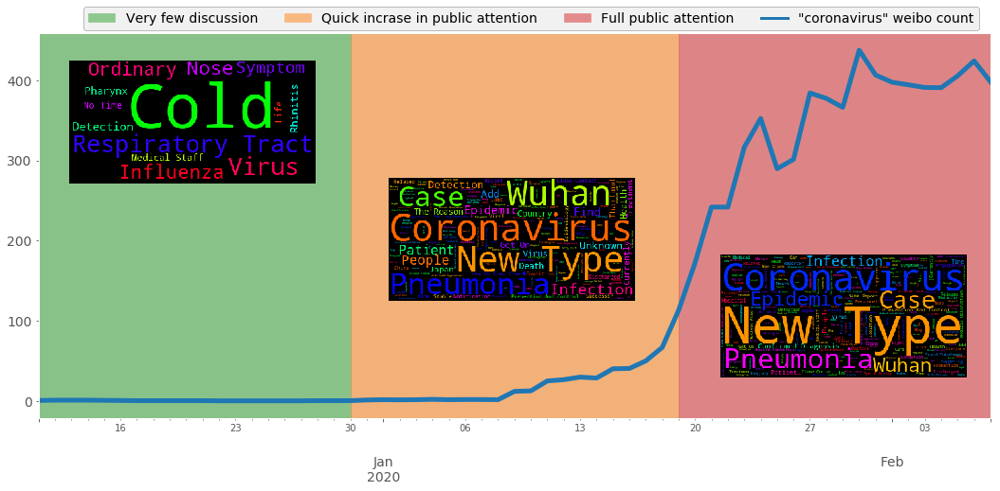

In [403]:
# now we do an embedded plot
col_name='item_e'
fig, ax = plt.subplots(1,1,figsize=(18,7.5))
wb_count_to_plot=wb_count[topic_e].fillna(0).rolling(5,min_periods=1).mean().loc[start_date:].plot(ax=ax,lw=5,color=uc.alt_colors_quick[0])
ax.set_xlabel('')
ax.grid(False)
legend_elements=[]

for period in periods:
    info_i=key_periods[period]
    start_i=info_i[0]
    end_i=info_i[1]
    color_i=info_i[2]
    
    ax.axvspan(start_i, end_i, alpha=0.5, color=uc.alt_colors_quick[color_i])
    
    wc_to_use=WordCloud(
        background_color='black',
        #mask=backgroup_mask,   
        max_words=1000,
        #font_path=font_path,
        max_font_size=100,
        colormap='hsv',
        
#         width=800,
#         height =100,
        )
    
    legend_elements.append(Patch(facecolor=uc.alt_colors_quick[color_i], edgecolor=uc.alt_colors_quick[color_i],alpha=0.5,label=period))
    
legend_elements.append(Line2D([0], [0], color=uc.alt_colors_quick[0], lw=3, label='"%s" weibo count' % (topic_e)))
ax.legend(handles=legend_elements, loc='upper left',framealpha=0.5,fancybox=True,fontsize=14,ncol=4,
         bbox_to_anchor=(0.04,1.085)).get_frame().set_edgecolor('k')
ax.tick_params(axis='both', which='major', labelsize=14)


# sub axes
left, bottom, width, height = [0.15, 0.58, 0.2, 0.25]
ax_1 = fig.add_axes([left, bottom, width, height])

left, bottom, width, height = [0.41, 0.35, 0.2, 0.25]
ax_2 = fig.add_axes([left, bottom, width, height])

left, bottom, width, height = [0.68, 0.2, 0.2, 0.25]
ax_3 = fig.add_axes([left, bottom, width, height])

sub_axes=[ax_1,ax_2,ax_3]

for i,period in enumerate(periods):
    info_i=key_periods[period]
    start_i=info_i[0]
    end_i=info_i[1]
    color_i=info_i[2]
    
    freq_i=freq.loc[start_i:end_i].groupby(col_name).sum()['prop'].to_dict()
    word_cloud =wc_to_use.generate_from_frequencies(freq_i)
    
    sub_axes[i].imshow(word_cloud)
    sub_axes[i].axis("off")

